<a href="https://colab.research.google.com/github/nutapol97/Deep-Reinforcement-learning/blob/main/Rl_project_PPO.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#!git clone https://github.com/NotAnyMike/gym.git
#/usr/local/lib/python3.7/dist-packages/gym/envs/box2d
#/usr/local/lib/python3.7/
#https://github.com/nutapol97/Deep_RL_Projec_Car_Racing.git

Cloning into 'gym'...
remote: Enumerating objects: 10397, done.
remote: Total 10397 (delta 0), reused 0 (delta 0), pack-reused 10397
Receiving objects: 100% (10397/10397), 12.02 MiB | 28.48 MiB/s, done.
Resolving deltas: 100% (7128/7128), done.


In [1]:
cd /usr/local/lib/python3.7/

/usr/local/lib/python3.7


In [2]:
!git clone https://github.com/nutapol97/Deep_RL_Projec_Car_Racing.git

Cloning into 'Deep_RL_Projec_Car_Racing'...
remote: Enumerating objects: 492, done.
remote: Counting objects: 100% (492/492), done.
remote: Compressing objects: 100% (389/389), done.
remote: Total 492 (delta 156), reused 432 (delta 99), pack-reused 0
Receiving objects: 100% (492/492), 930.55 KiB | 5.06 MiB/s, done.
Resolving deltas: 100% (156/156), done.


In [3]:
!pip install stable-baselines3[extra] pyvirtualdisplay  pyglet==v1.3.2 gym[box2d]
!apt-get install python-opengl -y

     |████████████████████████████████| 177 kB 4.3 MB/s 
     |████████████████████████████████| 1.0 MB 25.9 MB/s 
     |████████████████████████████████| 626 kB 80.9 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
     |████████████████████████████████| 2.1 MB 74.6 MB/s 
     |████████████████████████████████| 18.3 MB 23.3 MB/s 
     |████████████████████████████████| 176 kB 47.7 MB/s 
     |████████████████████████████████| 174 kB 70.5 MB/s 
     |████████████████████████████████| 161 kB 67.2 MB/s 
  Created wheel for gym: filename=gym-0.23.1-py3-none-any.whl size=701375 sha256=272c2dfae169ca1463a8cfe1264a785cb1a9694e115f47a3602bc07b0a7cf6fc
  Stored in directory: /root/.cache/pip/wheels/e3/33/04/6723848e46f0f1ebe794bb329b7c761c3329a0d7ffade99da7
Successfully built gym
  Attempting uninstall: gym
    Found existing installation: gym 0.17.3
    Uninstalling gym-0.17.3:
      Successfully uninstalled gy

In [ ]:
!apt-get install x11-utils > /dev/null 2>&1 
!pip install pyglet > /dev/null 2>&1 
!apt-get install -y xvfb python-opengl > /dev/null 2>&1

In [ ]:
!pip install gym pyvirtualdisplay > /dev/null 2>&1

**Instruction**


1.   Please see the https://github.com/NotAnyMike/gym and study how to use and modify the CarRacing environment
Setup the CarRacing environment as:
Use the original map in CarRacing-v0
2.   Add random obstacles: 50 obstacles
In the github respository, you can view and modify the code of CarRacing in https://github.com/NotAnyMike/gym/blob/master/gym/envs/box2d/car_racing.py
3. You can modify the Reward: This is very important for Reinforcement learning player.
4. Modify the out of lane farer than 30% will be stopped the episode.
5. Modify the continuous running to be stopped after 5400 steps.
6. Find the way how to calculate percentage of car running in each lap.
If your car runs 1 lap, count it.
7. Count the obstacles is hit.
8. 
Do not go out of the lane. Count the number of frames which go out of the lane.Please show the frame number.







In [6]:
import numpy as np 
import pandas as pd
import gym
import os
from stable_baselines3 import PPO      #PPO -> Proximal Policy Optimization
from stable_baselines3.common.vec_env import DummyVecEnv 
from stable_baselines3.common.evaluation import evaluate_policy  #to evaluate the model 
from stable_baselines3.common.callbacks import EvalCallback

In [7]:
from pyvirtualdisplay import Display
display = Display(visible=0, size=(1024, 768))
display.start()


from matplotlib import pyplot as plt, animation
%matplotlib inline
from IPython import display

def create_anim(frames, dpi, fps):
    plt.figure(figsize=(frames[0].shape[1] / dpi, frames[0].shape[0] / dpi), dpi=dpi)
    patch = plt.imshow(frames[0])
    def setup():
        plt.axis('off')
    def animate(i):
        patch.set_data(frames[i])
    anim = animation.FuncAnimation(plt.gcf(), animate, init_func=setup, frames=len(frames), interval=fps)
    return anim

def display_anim(frames, dpi=72, fps=60):
    anim = create_anim(frames, dpi, fps)
    return anim.to_jshtml()

def save_anim(frames, filename, dpi=72, fps=50):
    anim = create_anim(frames, dpi, fps)
    anim.save(filename)


class trigger:
    def __init__(self):
        self._trigger = True

    def __call__(self, e):
        return self._trigger

    def set(self, t):
        self._trigger = t

In [10]:
environment_name = 'CarRacing-v1'    
env = gym.make(environment_name)

In [13]:
frames = []
episodes = 1
for episode in range(1, episodes+1):
    state = env.reset()
    done = False
    score = 0
    
    while not done:
        frames.append(env.render(mode='rgb_array'))
        action = env.action_space.sample()
        n_state, reward, done,info = env.step(action)
        score += reward
    print("Episode:{} Score:{}".format(episode,score))
env.close()

Track generation: 1127..1415 -> 288-tiles track
retry to generate track (normal if there are not many of this messages)
Track generation: 1012..1269 -> 257-tiles track


/usr/local/lib/python3.7/dist-packages/gym/utils/seeding.py:48: DeprecationWarning: WARN: Function `rng.randint(low, [high, size, dtype])` is marked as deprecated and will be removed in the future. Please use `rng.integers(low, [high, size, dtype])` instead.
  "Function `rng.randint(low, [high, size, dtype])` is marked as deprecated "
/usr/local/lib/python3.7/dist-packages/gym/envs/box2d/car_racing.py:1813: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  arr = np.fromstring(image_data.data, dtype=np.uint8, sep='')


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


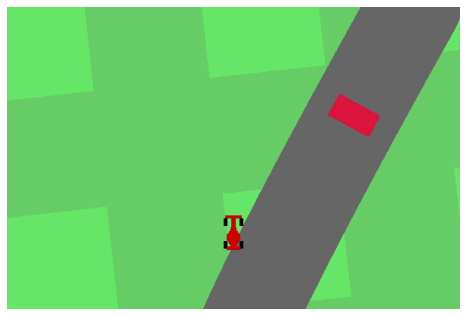

In [12]:
display.HTML(display_anim(frames))

In [ ]:
env = gym.make(environment_name)
env = DummyVecEnv([lambda: env])

In [ ]:
from stable_baselines3.common.callbacks import CheckpointCallback
env = gym.make(environment_name)
env = DummyVecEnv([lambda: env])

log_path = os.path.join('/content/drive/MyDrive/RL_project/Training/Logs')
model = PPO('CnnPolicy', env, verbose=1, tensorboard_log=log_path)
ppo_path = os.path.join('/content/drive/MyDrive/RL_project/Training/Saved_Models/PPO_car_best_Model')
checkpoint_callback = CheckpointCallback(save_freq=1000, save_path='/content/drive/MyDrive/RL_project/logs/',name_prefix='rl_model_new')

eval_env = model.get_env()

eval_callback = EvalCallback(eval_env=eval_env, best_model_save_path=ppo_path,
                              n_eval_episodes=5,
                              eval_freq=50000,verbose=1,
                              deterministic=True, render=False)

model.learn(total_timesteps=10000000,callback=eval_callback)
ppo_path = os.path.join('/content/drive/MyDrive/RL_project/Training/Saved_Models/PPO_2m_Model_final')
model.save(ppo_path)

Using cuda device
Wrapping the env in a VecTransposeImage.
Track generation: 1115..1408 -> 293-tiles track
retry to generate track (normal if there are not many of this messages)
Track generation: 1357..1700 -> 343-tiles track


/usr/local/lib/python3.7/dist-packages/gym/utils/seeding.py:48: DeprecationWarning: WARN: Function `rng.randint(low, [high, size, dtype])` is marked as deprecated and will be removed in the future. Please use `rng.integers(low, [high, size, dtype])` instead.
  "Function `rng.randint(low, [high, size, dtype])` is marked as deprecated "
/usr/local/lib/python3.7/dist-packages/past/types/oldstr.py:5: DeprecationWarning: Using or importing the ABCs from 'collections' instead of from 'collections.abc' is deprecated since Python 3.3,and in 3.9 it will stop working
  from collections import Iterable
/usr/local/lib/python3.7/dist-packages/past/builtins/misc.py:4: DeprecationWarning: Using or importing the ABCs from 'collections' instead of from 'collections.abc' is deprecated since Python 3.3,and in 3.9 it will stop working
  from collections import Mapping
/usr/local/lib/python3.7/dist-packages/gym/envs/box2d/car_racing.py:1805: DeprecationWarning: The binary mode of fromstring is deprecated, 

Logging to /content/drive/MyDrive/RL_project/Training/Logs/PPO_37


/usr/local/lib/python3.7/dist-packages/gym/envs/box2d/car_racing.py:1805: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  arr = np.fromstring(image_data.data, dtype=np.uint8, sep='')


Track generation: 1078..1358 -> 280-tiles track


/usr/local/lib/python3.7/dist-packages/gym/utils/seeding.py:48: DeprecationWarning: WARN: Function `rng.randint(low, [high, size, dtype])` is marked as deprecated and will be removed in the future. Please use `rng.integers(low, [high, size, dtype])` instead.
  "Function `rng.randint(low, [high, size, dtype])` is marked as deprecated "


Track generation: 1088..1371 -> 283-tiles track
-----------------------------
| time/              |      |
|    fps             | 62   |
|    iterations      | 1    |
|    time_elapsed    | 32   |
|    total_timesteps | 2048 |
-----------------------------
Track generation: 1262..1581 -> 319-tiles track
Track generation: 1176..1474 -> 298-tiles track
-----------------------------------------
| time/                   |             |
|    fps                  | 64          |
|    iterations           | 2           |
|    time_elapsed         | 63          |
|    total_timesteps      | 4096        |
| train/                  |             |
|    approx_kl            | 0.006961455 |
|    clip_fraction        | 0.106       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.6        |
|    explained_variance   | -0.00284    |
|    learning_rate        | 0.0003      |
|    loss                 | -0.00966    |
|    n_updates            | 10          |
|    policy_grad

/usr/local/lib/python3.7/dist-packages/stable_baselines3/common/evaluation.py:69: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  UserWarning,


Track generation: 1075..1348 -> 273-tiles track
Track generation: 1262..1581 -> 319-tiles track
Track generation: 1105..1383 -> 278-tiles track
Track generation: 1082..1356 -> 274-tiles track
Track generation: 1179..1478 -> 299-tiles track
Track generation: 1267..1587 -> 320-tiles track
Eval num_timesteps=5000, episode_reward=-111.44 +/- 44.71
Episode length: 946.40 +/- 107.20
-----------------------------------------
| eval/                   |             |
|    mean_ep_length       | 946         |
|    mean_reward          | -111        |
| time/                   |             |
|    total timesteps      | 5000        |
| train/                  |             |
|    approx_kl            | 0.009878097 |
|    clip_fraction        | 0.105       |
|    clip_range           | 0.2         |
|    entropy_loss         | -1.6        |
|    explained_variance   | 0.175       |
|    learning_rate        | 0.0003      |
|    loss                 | 0.0206      |
|    n_updates            | 20  

In [ ]:
ppo_path = os.path.join('/content/drive/MyDrive/RL_project/Training/Saved_Models/สำเนาของ Best_of_best_model.zip')
model = PPO.load(ppo_path, env=env)
env = gym.make(environment_name)
env = DummyVecEnv([lambda: env])
#ppo_path = os.path.join('/content/Training/Saved_Models/PPO_2m_Model_final.zip')
episodes = 2
frames = []
for episode in range(1, episodes+1):
    obs = env.reset()  #state = env.reset()
    done = False
    score = 0
    while not done:
        frames.append(env.render(mode='rgb_array'))
        action , _ = model.predict(obs) 
        obs, reward, done, info = env.step(action) 
        score += reward
        env.step.
    print("Episode:{} Score:{}".format(episode,score))
env.close()

obs_count 3
Track generation: 1404..1758 -> 354-tiles track
Episode:2 Score:[61.000618]


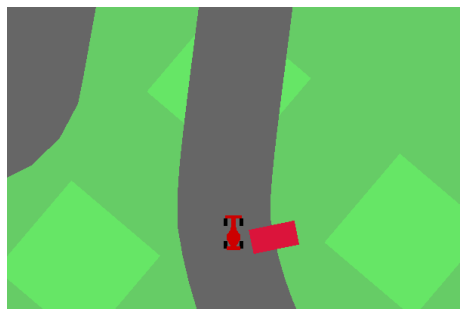

In [ ]:
display.HTML(display_anim(frames))

In [ ]:
from stable_baselines3.common.callbacks import CheckpointCallback
env = gym.make(environment_name)
env = DummyVecEnv([lambda: env])

log_path = os.path.join('/content/drive/MyDrive/RL_project/Training/Logs')
ppo_path = os.path.join('/content/drive/MyDrive/RL_project/Training/Saved_Models/สำเนาของ Best_of_best_model.zip')
model = PPO.load(ppo_path, env=env, verbose=1, tensorboard_log=log_path)

ppo_path = os.path.join('/content/drive/MyDrive/RL_project/Training/Saved_Models/PPO_car_best_Model')
checkpoint_callback = CheckpointCallback(save_freq=1000, save_path='/content/drive/MyDrive/RL_project/logs/',name_prefix='rl_model_new')

eval_env = model.get_env()
eval_callback = EvalCallback(eval_env=eval_env, best_model_save_path=ppo_path,
                              n_eval_episodes=5,
                              eval_freq=5000,verbose=1,
                              deterministic=True, render=False)

model.learn(total_timesteps=10000000,callback=eval_callback)
ppo_path = os.path.join('/content/drive/MyDrive/RL_project/Training/Saved_Models/PPO_2m_Model_final')
model.save(ppo_path)

Wrapping the env in a VecTransposeImage.
Track generation: 1045..1314 -> 269-tiles track
retry to generate track (normal if there are not many of this messages)
Track generation: 1028..1289 -> 261-tiles track


/usr/local/lib/python3.7/dist-packages/gym/utils/seeding.py:48: DeprecationWarning: WARN: Function `rng.randint(low, [high, size, dtype])` is marked as deprecated and will be removed in the future. Please use `rng.integers(low, [high, size, dtype])` instead.
  "Function `rng.randint(low, [high, size, dtype])` is marked as deprecated "
/usr/local/lib/python3.7/dist-packages/gym/envs/box2d/car_racing.py:1813: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  arr = np.fromstring(image_data.data, dtype=np.uint8, sep='')


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


/usr/local/lib/python3.7/dist-packages/scipy/fft/__init__.py:97: DeprecationWarning: The module numpy.dual is deprecated.  Instead of using dual, use the functions directly from numpy or scipy.
  from numpy.dual import register_func
/usr/local/lib/python3.7/dist-packages/scipy/sparse/sputils.py:17: DeprecationWarning: `np.typeDict` is a deprecated alias for `np.sctypeDict`.
  supported_dtypes = [np.typeDict[x] for x in supported_dtypes]
/usr/local/lib/python3.7/dist-packages/scipy/special/orthogonal.py:81: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecati

Logging to /content/drive/MyDrive/RL_project/Training/Logs/PPO_40


/usr/local/lib/python3.7/dist-packages/gym/envs/box2d/car_racing.py:1813: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  arr = np.fromstring(image_data.data, dtype=np.uint8, sep='')


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


/usr/local/lib/python3.7/dist-packages/gym/utils/seeding.py:48: DeprecationWarning: WARN: Function `rng.randint(low, [high, size, dtype])` is marked as deprecated and will be removed in the future. Please use `rng.integers(low, [high, size, dtype])` instead.
  "Function `rng.randint(low, [high, size, dtype])` is marked as deprecated "


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0


/usr/local/lib/python3.7/dist-packages/stable_baselines3/common/evaluation.py:69: UserWarning: Evaluation environment is not wrapped with a ``Monitor`` wrapper. This may result in reporting modified episode lengths and rewards, if other wrappers happen to modify these. Consider wrapping environment first with ``Monitor`` wrapper.
  UserWarning,


Streaming output truncated to the last 5000 lines.
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
385
3

In [ ]:
 env.